In [2]:
import numpy as np
import scipy
import robust_mean_estimate as rl
import importlib as il
from scipy import special
from numpy import linalg as LA
import matplotlib.pyplot as plt
%matplotlib inline
import mpld3
mpld3.enable_notebook()

fsize = 20
fpad = 10
figsize = (8,4)
fontname = 'fantasy'

In [3]:
"loss, time vs dimension -- pareto -- dense biased -- set data"

il.reload(rl)

trials = 50

m, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 400, 10))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)

inputfilename = 'data/loss-time-vs-dimension-pareto.pkl'
plot_d = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_d.setdata_tofile(filename = inputfilename, xvar_name = 'd', trials = trials, xs = xs)

[[ 8.55095153 -6.17169929 -0.96038924 ... -1.07270216  1.71151753
   1.2711624 ]
 [ 8.87820471 -3.99403618 -3.00943487 ...  1.91531925 -1.0144953
  -1.34621984]
 [ 8.6558501  -6.04257018 -4.74085314 ...  1.02117944  1.06525715
  -1.20642649]
 ...
 [ 6.85992825 -5.7598844  -5.68622214 ... -3.47638546 -4.52231951
  -0.79449759]
 [ 9.06259221 -5.98901726 -5.01625006 ... -0.68640619 -0.32133992
  -3.26777961]
 [ 6.91328512 -5.31914916 -2.514501   ...  0.59798344 -0.93757722
  -3.21498093]]
ATTENTION
[[-0.6309405161827583],[-2.351184323066419],[-4.995702866560341],[9.770458840923489]]
[40  2  1  0]
[ 9.95101323e+00 -5.13614098e+00 -1.88951849e+00  4.00238147e-01
 -3.96258008e-04 -2.09591556e-02 -3.96258008e-04  7.23924787e-06
 -7.23924787e-06 -6.53861747e-01 -7.23924787e-06  3.96258008e-04
 -1.46045315e-01 -7.23924787e-06 -1.37112189e-01 -2.09591556e-02
 -3.96258008e-04 -2.09591556e-02 -3.96258008e-04 -2.75867675e-01
 -7.23924787e-06 -1.40243385e-01  7.23924787e-06 -1.62583559e-02
  3.96258

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:336: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")
/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:354: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")
/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:311: RuntimeWarning: divide by zero encountered in true_divide
  return 8*np.exp(-T**2/2) + 8*eps/((T**2)*np.log(d*np.log(d/eps*tau)))


Linear filter...
Filtered out 0/75, 0.0 false (nan vs 0.1)
Quadratic filter...
Filtered out 0/75, 0.0 false (nan vs 0.1)
condition 75 75
Could not filter
Linear filter...
Filtered out 0/13, 0.0 false (nan vs 0.1)
Could not filter
[[ 8.43706256 -3.73000534 -3.2041549  ...  1.42378808 -1.33057121
   1.23747439]
 [12.10180503 -3.56663407 -3.02506927 ... -1.45153939 -1.2915608
  -1.31299882]
 [ 8.84100846 -6.87575343 -0.66385869 ... -1.40279068 -1.18045465
   1.07247518]
 ...
 [ 6.76537271 -9.08452414 -2.54590773 ... -0.97050561 -3.04165507
  -3.25712046]
 [ 6.59934847 -8.46548854 -5.60530936 ... -3.08372907 -0.9565219
   0.34423231]
 [ 6.68593632 -5.52985942 -2.72146312 ... -3.272999   -3.97765299
  -0.95590638]]
ATTENTION
[[0.6630287190778261],[-2.0616976423276014],[-5.187015953167689],[9.791351003560994]]
[3 2 1 0]
[ 9.85701512e+00 -5.13371580e+00 -2.01238758e+00  6.67136856e-01
 -1.58299325e-03 -1.23095195e-01 -3.96258008e-04 -2.09591556e-02
  3.96258008e-04  1.63836530e-01  1.72032957

In [ ]:
"loss vs dimension -- pareto -- dense biased -- plot"

il.reload(rl)

trials = 50

m, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 400, 10))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-dimension-pareto.pkl'
outputfilename = 'figs/loss-vs-dimension-pareto.pdf'

title = 'm = {m}, k = {k}, eps = {eps}. Model is Pareto. Noise is constant -2 biased.'.format(m = m, k = k, eps = eps)
xlabel = 'd'
ylabel = 'L2 Loss'

plot_d_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_d_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"loss vs dimension -- pareto -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

m, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 400, 10))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.Top_K_Filtered, rl.RME_sp]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-dimension-pareto.pkl'
outputfilename = 'figs/loss-vs-dimension-pareto-detailed.pdf'

title = 'm = {m}, k = {k}, eps = {eps}. Model is Pareto. Noise is constant -2 biased.'.format(m = m, k = k, eps = eps)
xlabel = 'd'
ylabel = 'L2 Loss'

plot_d_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_d_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs dimension -- pareto -- dense biased -- plot"

il.reload(rl)

trials = 50

m, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 400, 10))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)

outputfilename = 'figs/time-vs-dimension-pareto.pdf'
inputfilename = 'data/loss-time-vs-dimension-pareto.pkl'
title = 'm = {m}, k = {k}, eps = {eps}. Model is Pareto. Noise is constant -2 biased.'.format(m = m, k = k, eps = eps)
xlabel = 'd'
ylabel = 'Time'

plot_d_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_d_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs dimension -- pareto -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

m, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 400, 10))

keys = [rl.Oracle, rl.RME_sp, rl.RME]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(m = m, k = k, eps = eps)

outputfilename = 'figs/time-vs-dimension-pareto-detailed.pdf'
inputfilename = 'data/loss-time-vs-dimension-pareto.pkl'
title = 'm = {m}, k = {k}, eps = {eps}. Model is Pareto. Noise is constant -2 biased.'.format(m = m, k = k, eps = eps)
xlabel = 'd'
ylabel = 'Time'

plot_d_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_d_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [4]:
"loss, time vs sparsity -- pareto -- dense biased -- set data"

il.reload(rl)

trials = 50

m, d, eps = 200, 100, 0.1
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-0.2)
model_params = rl.Params(m = m, d = d, eps = eps)

inputfilename = 'data/loss-time-vs-sparsity-pareto.pkl'
plot_k = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_k.setdata_tofile(filename = inputfilename, xvar_name = 'k', trials = trials, xs = xs)

[[-0.17381044 -0.11956765  2.31922521 ... -6.78986215  1.50874809
  -1.97684826]
 [-0.01341369 -0.16141613  3.34756188 ... -1.35732151 -1.02290628
  -1.53972003]
 [-0.43446756 -0.16427155  2.60846894 ...  1.18723657 -1.43092237
   8.53185035]
 ...
 [-0.51752868  1.90230541 -0.85356891 ... -1.31189179 -1.38942908
   1.38862134]
 [ 2.40626096 -0.36573854 -0.31935843 ...  1.9369305   0.89055263
  -1.78696854]
 [ 1.94640548 -0.33741977  1.95688561 ... -2.19469423 -1.4647813
  -1.53204526]]
ATTENTION
[[0.8081483428427532],[1.0910004374844784],[1.040235426389373],[0.9049009718531849]]
[1 3 2 0]
[ 9.26126673e-01  8.75454445e-01  1.01048056e+00  1.10922867e+00
  2.88756694e-03 -7.23924787e-06 -2.88756694e-03 -7.23924787e-06
  2.52549689e-01  7.23924787e-06 -3.96258008e-04  2.88756694e-03
 -4.08894373e-02 -5.41460901e-05 -2.88756694e-03 -3.96258008e-04
 -1.99854339e-02  1.47280064e-02  0.00000000e+00  3.96258008e-04
  7.23924787e-06  0.00000000e+00  5.41460901e-05  1.45197346e-03
  5.41460901e-

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:336: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")
/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:354: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")


Linear filter...
Filtered out 0/170, 0.0 false (nan vs 0.1)
Quadratic filter...
Filtered out 0/170, 0.0 false (nan vs 0.1)
condition 170 170
Could not filter
Linear filter...
Filtered out 14/31, 12.0 false (0.86 vs 0.1)
Linear filter...
Filtered out 9/17, 9.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 4/8, 4.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 0/4, 0.0 false (nan vs 0.1)
Could not filter


/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:311: RuntimeWarning: divide by zero encountered in true_divide
  return 8*np.exp(-T**2/2) + 8*eps/((T**2)*np.log(d*np.log(d/eps*tau)))


[[ 9.36376832  2.05766898 -0.02811945 ... -1.08626324 -1.09982576
  -1.0417717 ]
 [-0.01307825 -0.04756978  2.13942414 ... -1.13920774  2.70831517
  -1.4011519 ]
 [ 2.08180561 -0.51765266  2.21679137 ...  1.03703795  1.17636599
  -1.31776869]
 ...
 [ 1.98290507  1.94145031  1.83636708 ...  1.88843327  2.25099169
  -2.28136835]
 [-0.32761923  1.84209747  2.90864803 ...  0.92307786  0.81179734
  -1.25460939]
 [ 2.01310384  2.30498813  2.54210483 ... -1.22078998 -2.14475446
  -1.57204594]]
ATTENTION
[[1.1029813337641],[0.9814423678639761],[0.8974014562449181],[0.9122176720175326],[1.022516880929796],[1.0377562492952759],[1.1351028203639104],[1.0914960855752036]]
[1 2 6 7 5 0 3 4]
[ 1.03099165e+00  9.55722916e-01  9.67826591e-01  1.07393705e+00
  1.09016136e+00  1.02665112e+00  1.01032654e+00  9.80758696e-01
 -2.88756694e-03 -5.41460901e-05 -4.32852553e-01 -2.52353789e-01
 -7.23924787e-06  2.88756694e-03 -7.23924787e-06 -3.96258008e-04
  0.00000000e+00 -3.96258008e-04  5.41460901e-05  7.23

AttributeError: 'XAxis' object has no attribute '_gridOnMajor'

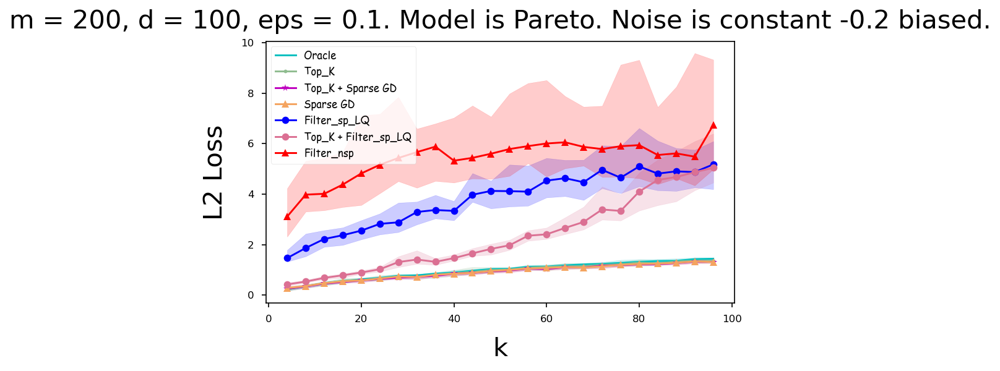

<Figure size 1200x600 with 0 Axes>

In [7]:
"loss vs sparsity -- pareto -- dense biased -- plot"

il.reload(rl)

trials = 50

m, d, eps = 200, 100, 0.1
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-0.2)
model_params = rl.Params(m = m, d = d, eps = eps)
inputfilename = 'data/loss-time-vs-sparsity-pareto.pkl'
outputfilename = 'figs/loss-vs-sparsity-pareto.pdf'

title = 'm = {m}, d = {d}, eps = {eps}. Model is Pareto. Noise is constant -0.2 biased.'.format(m = m, d = d, eps = eps)
xlabel = 'k'
ylabel = 'L2 Loss'

plot_k_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_k_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

AttributeError: 'XAxis' object has no attribute '_gridOnMajor'

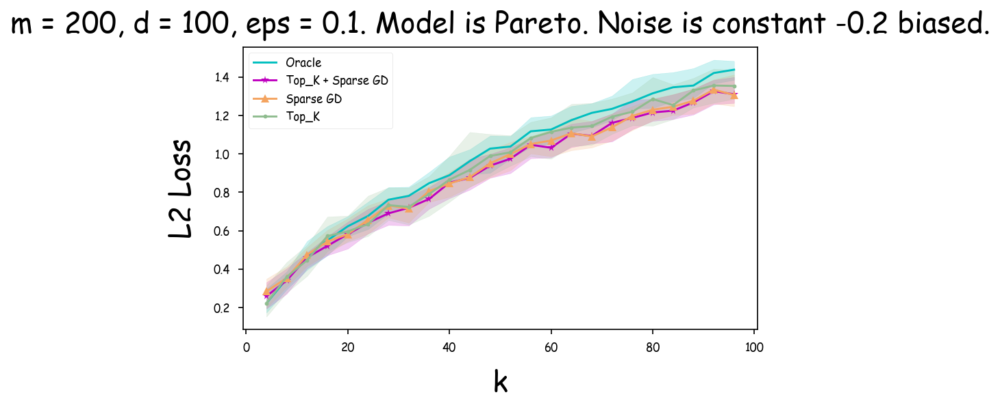

<Figure size 1200x600 with 0 Axes>

In [9]:
"loss vs sparsity -- pareto -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

m, d, eps = 200, 100, 0.1
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.Topk_GD, rl.GDAlgs, rl.Top_K]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-0.2)
model_params = rl.Params(m = m, d = d, eps = eps)
inputfilename = 'data/loss-time-vs-sparsity-pareto.pkl'
outputfilename = 'figs/loss-vs-sparsity-pareto-detailed.pdf'

title = 'm = {m}, d = {d}, eps = {eps}. Model is Pareto. Noise is constant -0.2 biased.'.format(m = m, d = d, eps = eps)
xlabel = 'k'
ylabel = 'L2 Loss'

plot_k_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_k_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs sparsity -- pareto -- dense biased -- plot"

il.reload(rl)

trials = 50

m, d, eps = 200, 100, 0.1
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-0.2)
model_params = rl.Params(m = m, d = d, eps = eps)
inputfilename = 'data/loss-time-vs-sparsity-pareto.pkl'
outputfilename = 'figs/time-vs-sparsity-pareto.pdf'

title = 'm = {m}, d = {d}, eps = {eps}. Model is Pareto. Noise is constant -0.2 biased.'.format(m = m, d = d, eps = eps)
xlabel = 'k'
ylabel = 'Time'

plot_k_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_k_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs sparsity -- pareto -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

m, d, eps = 200, 100, 0.1
xs = list(np.arange(4, 100, 4))

keys = [rl.Oracle, rl.RME_sp, rl.RME]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-0.2)
model_params = rl.Params(m = m, d = d, eps = eps)
inputfilename = 'data/loss-time-vs-sparsity-pareto.pkl'
outputfilename = 'figs/time-vs-sparsity-pareto-detailed.pdf'

title = 'm = {m}, d = {d}, eps = {eps}. Model is Pareto. Noise is constant -0.2 biased.'.format(m = m, d = d, eps = eps)
xlabel = 'k'
ylabel = 'Time'

plot_k_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_k_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [5]:
"loss, time vs sample -- pareto -- dense biased -- set data"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 1000, 50))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)

inputfilename = 'data/loss-time-vs-sample-pareto.pkl'
plot_m = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_m.setdata_tofile(filename = inputfilename, xvar_name = 'd', trials = trials, xs = xs)

[[ 8.68315038 -3.76695853 -3.18937019 ... -1.05977467  1.05188218
  -2.21156875]
 [ 8.81668987 -6.36085126 -0.741168   ... -1.49038663  1.15888657
   1.49404847]
 [ 6.8264145  -6.18741644 -3.06604668 ... -1.18396734 -1.98644661
   1.65894719]
 ...
 [ 6.44002088 -8.27354139 -5.14138577 ... -0.63894929 -0.99574067
  -0.95203592]
 [10.53107833 -9.24381061 -5.18516533 ... -0.01345195 -3.05440314
  -0.99686405]
 [ 9.36861431 -3.62147859 -5.17871254 ... -3.03540037 -3.17465716
  -0.47594547]]
ATTENTION
[[0.8135277407702409],[-2.135393578488329],[-5.1569226846778395],[9.739295815717094]]
[3 2 1 0]
[ 9.81670746e+00 -5.11368663e+00 -1.99944580e+00  8.86582693e-01
 -2.61846927e-02  8.21438980e-07 -9.48946746e-03 -3.01675195e-06
 -1.76891583e-02 -8.06563523e-05 -7.23924787e-06 -3.96258008e-04
 -2.09591556e-02 -1.63198578e-05 -7.99735197e-02  3.01675195e-06
 -4.29375225e-03 -8.06563523e-05 -7.23924787e-06 -1.94159532e-03
 -3.63352618e-05 -1.94159532e-03 -8.06563523e-05 -3.63352618e-05
 -1.39645839

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:336: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")
/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:354: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")


Linear filter...
Filtered out 5/439, 0.0 false (0.00 vs 0.1)
Linear filter...
Filtered out 0/434, 0.0 false (nan vs 0.1)
Quadratic filter...
Filtered out 0/434, 0.0 false (nan vs 0.1)
condition 434 434
Could not filter
Linear filter...
Filtered out 10/80, 2.0 false (0.20 vs 0.1)
Linear filter...
Filtered out 15/70, 15.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 25/55, 25.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 14/30, 14.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 0/16, 0.0 false (nan vs 0.1)
Could not filter


/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:311: RuntimeWarning: divide by zero encountered in true_divide
  return 8*np.exp(-T**2/2) + 8*eps/((T**2)*np.log(d*np.log(d/eps*tau)))


[[ 8.90038432 -6.26130605 -0.71817593 ... -1.84348005  1.40594575
  -1.50579423]
 [11.05757439 -3.76328209 -3.38754353 ... -1.93047403  1.62944746
  -2.55596563]
 [ 8.12742117 -3.31134098 -3.20571847 ... -1.08531555  1.34016331
  -1.6124012 ]
 ...
 [ 6.97547385 -8.15270904 -5.03471985 ... -0.84951242 -0.28042323
  -0.93588338]
 [ 6.97522437 -5.93105061 -2.91502394 ... -0.68259414  7.30195203
  -0.48982759]
 [ 9.04098365 -8.25288188 -1.2325634  ... -0.70809253 -3.06276916
  -3.32391214]]
ATTENTION
[[0.838214788566304],[-2.1508022129256323],[-5.104072764483915],[9.787481373505466]]
[3 2 1 0]
[ 9.73564143e+00 -4.98614225e+00 -2.08207591e+00  9.32971859e-01
 -1.63198578e-05 -4.29375225e-03  3.01675195e-06 -3.63352618e-05
 -4.29375225e-03  7.23924787e-06 -8.77417592e-04 -4.29375225e-03
 -1.92096419e-02 -3.01675195e-06  7.23924787e-06 -3.96258008e-04
 -8.06563523e-05 -4.29375225e-03 -3.01675195e-06 -1.63198578e-05
 -1.94159532e-03  4.28694218e-03 -1.50496580e-02 -3.96258008e-04
 -1.78840842e

AttributeError: 'XAxis' object has no attribute '_gridOnMajor'

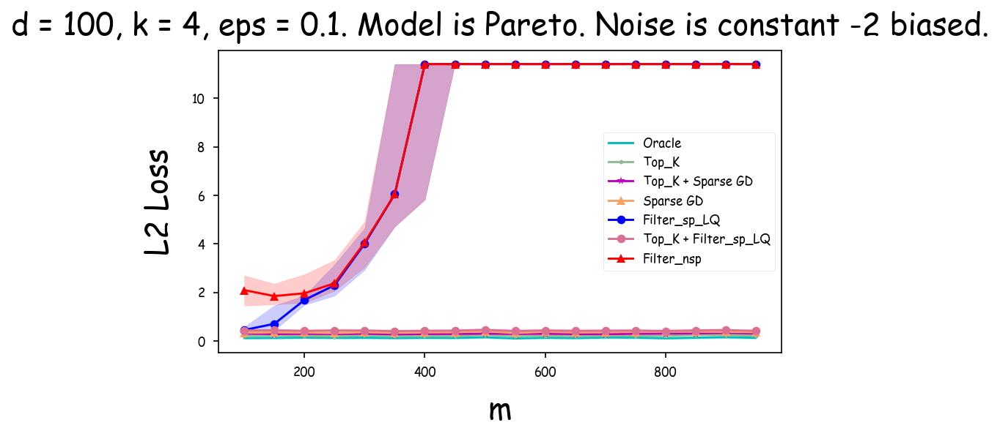

<Figure size 1200x600 with 0 Axes>

In [13]:
"loss vs sample -- pareto -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 1000, 50))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-sample-pareto.pkl'
outputfilename = 'figs/loss-vs-sample-pareto.pdf'

title = 'd = {d}, k = {k}, eps = {eps}. Model is Pareto. Noise is constant -2 biased.'.format(d = d, k = k, eps = eps)
xlabel = 'm'
ylabel = 'L2 Loss'

plot_m_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_m_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"loss vs sample -- pareto -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 1000, 50))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.Top_K_Filtered]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-sample-pareto.pkl'
outputfilename = 'figs/loss-vs-sample-pareto-detailed.pdf'

title = 'd = {d}, k = {k}, eps = {eps}. Model is Pareto. Noise is constant -2 biased.'.format(d = d, k = k, eps = eps)
xlabel = 'm'
ylabel = 'L2 Loss'

plot_m_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_m_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs sample -- pareto -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 1000, 50))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-sample-pareto.pkl'
outputfilename = 'figs/time-vs-sample-pareto.pdf'

title = 'd = {d}, k = {k}, eps = {eps}. Model is Pareto. Noise is constant -2 biased.'.format(d = d, k = k, eps = eps)
xlabel = 'm'
ylabel = 'Time'

plot_m_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_m_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs sample -- pareto -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, eps = 100, 4, 0.1
xs = list(np.arange(100, 1000, 50))

keys = [rl.Oracle, rl.RME_sp, rl.RME]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, eps = eps)
inputfilename = 'data/loss-time-vs-sample-pareto.pkl'
outputfilename = 'figs/time-vs-sample-pareto-detailed.pdf'

title = 'd = {d}, k = {k}, eps = {eps}. Model is Pareto. Noise is constant -2 biased.'.format(d = d, k = k, eps = eps)
xlabel = 'm'
ylabel = 'Time'

plot_m_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_m_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [6]:
"loss, time vs eps -- pareto -- dense biased -- set data"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.11, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)

inputfilename = 'data/loss-time-vs-eps-pareto.pkl'
plot_m = rl.load_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)
plot_m.setdata_tofile(filename = inputfilename, xvar_name = 'eps', trials = trials, xs = xs)

[[ 8.7221646  -3.89619418 -3.03058541 ...  1.34875008 -1.08947559
   1.00190902]
 [ 8.19089286 -8.65911821 -3.21515228 ...  1.28847052  1.00204791
   1.00696104]
 [ 6.8323336  -6.46811719 -0.84945852 ... -1.32856237  1.90469029
   1.27938383]
 ...
 [10.14406737 -5.80420673 -5.78111435 ... -0.42571037 -3.35779819
  -4.26658443]
 [ 9.52937348 -8.1250679  -5.05928287 ... -4.54339989 -0.58191261
  -3.0609958 ]
 [ 9.14061302 -9.00172846 -2.46376082 ... -3.01936289 -0.33450732
  -4.73444237]]
ATTENTION
[[0.9622533121805174],[-2.04553917292786],[-5.082784955276859],[10.01331301082204]]
[3 2 1 0]
[ 1.00115790e+01 -5.06148502e+00 -2.03355863e+00  9.90103146e-01
 -2.43669570e-05 -1.24759972e-05  0.00000000e+00  4.09966165e-06
 -5.39657659e-07  1.77564412e-06 -1.42716898e-05  0.00000000e+00
 -1.11779977e-06 -6.30109335e-06  3.03976336e-04  2.67455117e-07
 -5.39657659e-07 -7.23924787e-06 -2.13233429e-05 -3.52693751e-06
 -5.39657659e-07 -8.30562757e-06 -7.23924787e-06 -9.51908561e-06
 -2.65807771e-

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:336: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")
/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:354: RuntimeWarning: invalid value encountered in double_scalars
  f"Filtered out {l - len(idx[0])}/{l}, {bad_filtered} false ({bad_filtered / (l - len(idx[0])):0.2f} vs {self.fdr})")


Linear filter...
Filtered out 86/2704, 74.0 false (0.86 vs 0.1)
Linear filter...
Filtered out 31/2618, 31.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 36/2587, 36.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 38/2551, 37.0 false (0.97 vs 0.1)
Linear filter...
Filtered out 0/2513, 0.0 false (nan vs 0.1)
Quadratic filter...
Filtered out 0/2513, 0.0 false (nan vs 0.1)
condition 2513 2513
Could not filter
Linear filter...
Filtered out 73/708, 73.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 66/635, 65.0 false (0.98 vs 0.1)
Linear filter...
Filtered out 60/569, 60.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 54/509, 54.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 48/455, 48.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 52/407, 52.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 51/355, 51.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 46/304, 46.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 40/258, 40.0 false (1.00 vs 0.1)
Linear filter..

/Users/chenruidemac/Documents/GitHub/Robust_mean_estimation/robust_mean_estimate.py:311: RuntimeWarning: divide by zero encountered in true_divide
  return 8*np.exp(-T**2/2) + 8*eps/((T**2)*np.log(d*np.log(d/eps*tau)))


Linear filter...
Filtered out 22/63, 22.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 17/41, 17.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 14/24, 14.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 4/10, 4.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 3/6, 3.0 false (1.00 vs 0.1)
Linear filter...
Filtered out 0/3, 0.0 false (nan vs 0.1)
Could not filter
[[11.11421724 -8.11167268 -0.98266076 ... -1.41937616  3.41132988
   1.01471292]
 [ 8.93576477 -3.7886018  -3.17797858 ... -1.03758579  1.3619547
   1.08165953]
 [ 8.65811213 -6.21276455 -5.47810629 ...  1.32186301  1.26603182
   1.74553949]
 ...
 [ 6.90530975 -9.88692508 -2.44363189 ... -6.40515699 -3.88531167
  -3.59060782]
 [ 6.26901134 -5.0572166  -2.83182888 ... -3.02114054 -0.88062133
  -3.13635516]
 [ 9.88683429 -5.85611631 -2.72193581 ... -0.92615857 -4.26529981
   0.18049525]]
ATTENTION
[[0.9852152394948506],[-2.034642920919932],[-4.99961110796665],[9.928217078734948]]
[3 2 1 0]
[ 1.00011618e+01 -4.98641

AttributeError: 'XAxis' object has no attribute '_gridOnMajor'

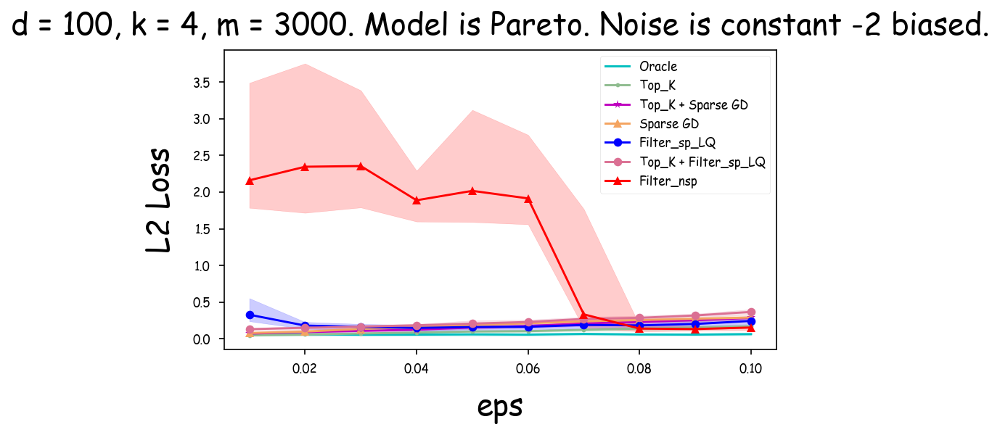

<Figure size 1200x600 with 0 Axes>

In [10]:
"loss vs eps -- pareto -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.11, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-eps-pareto.pkl'
outputfilename = 'figs/loss-vs-eps-pareto.pdf'

title = 'd = {d}, k = {k}, m = {m}. Model is Pareto. Noise is constant -2 biased.'.format(d = d, k = k, m = m)
xlabel = 'eps'
ylabel = 'L2 Loss'

plot_eps_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

AttributeError: 'XAxis' object has no attribute '_gridOnMajor'

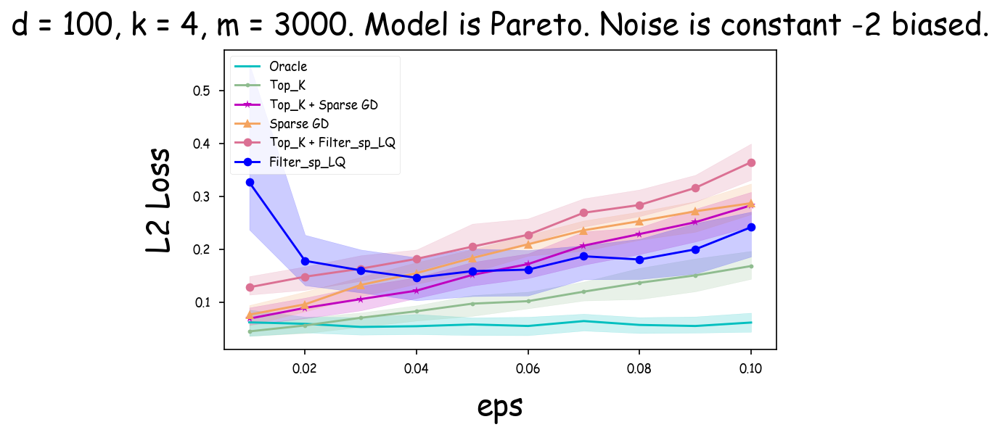

<Figure size 1200x600 with 0 Axes>

In [12]:
"loss vs eps -- pareto -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.11, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.Top_K_Filtered, rl.RME_sp]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-eps-pareto.pkl'
outputfilename = 'figs/loss-vs-eps-pareto-detailed.pdf'

title = 'd = {d}, k = {k}, m = {m}. Model is Pareto. Noise is constant -2 biased.'.format(d = d, k = k, m = m)
xlabel = 'eps'
ylabel = 'L2 Loss'

plot_eps_loss = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_loss.plotxy_fromfile(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs eps -- pareto -- dense biased -- plot"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.11, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-eps-pareto.pkl'
outputfilename = 'figs/time-vs-eps-pareto.pdf'

title = 'd = {d}, k = {k}, m = {m}. Model is Pareto. Noise is constant -2 biased.'.format(d = d, k = k, m = m)
xlabel = 'eps'
ylabel = 'Time'

plot_eps_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)

In [ ]:
"time vs eps -- pareto -- dense biased -- plot -- detailed"

il.reload(rl)

trials = 50

d, k, m = 100, 4, 3000
xs = list(np.arange(0.01, 0.11, 0.01))

keys = [rl.Oracle, rl.Top_K, rl.Topk_GD, rl.GDAlgs, rl.RME_sp, rl.Top_K_Filtered, rl.RME]

model = rl.ParetoModel()
noise_model = rl.DenseNoise(-2)
model_params = rl.Params(d = d, k = k, m = m)
inputfilename = 'data/loss-time-vs-eps-pareto.pkl'
outputfilename = 'figs/time-vs-eps-pareto-detailed.pdf'

title = 'd = {d}, k = {k}, m = {m}. Model is Pareto. Noise is constant -2 biased.'.format(d = d, k = k, m = m)
xlabel = 'eps'
ylabel = 'Time'

plot_eps_time = rl.plot_data(model = model, noise_model = noise_model, params = model_params, loss = rl.err, keys = keys)

plot_eps_time.plotxy_fromfile_time(outputfilename = outputfilename, filename = inputfilename, title = title, xlabel = xlabel, ylabel = ylabel, figsize = figsize, fsize = fsize, fpad = fpad, xs = xs, fontname = fontname)